# Advanced Certification in AIML
## A Program by IIIT-H and TalentSprint



#### Not for Grading

### Visualising CNN

In [1]:
#@title Case Study Walkthrough
#@markdown  Visualising CNN
from IPython.display import HTML

HTML("""<video width="320" height="240" controls>
  <source src="https://cdn.talentsprint.com/talentsprint/archives/sc/aiml/aiml_2018_b7_hyd/preview_videos/visualization_of_cnns.mp4">
</video>
""")

This experiment is based on the Visualization of filters in CNN.

## Setup Steps

In [2]:
#@title Please enter your registration id to start: { run: "auto", display-mode: "form" }
Id = "2418580" #@param {type:"string"}


In [3]:
#@title Please enter your password (normally your phone number) to continue: { run: "auto", display-mode: "form" }
password = "9898989865" #@param {type:"string"}


In [4]:
#@title Run this cell to complete the setup for this Notebook
from IPython import get_ipython

ipython = get_ipython()

notebook= "U3W15_CS_Visualising_CNN" #name of the notebook
Answer = "Ungraded"
def setup():
#  ipython.magic("sx pip3 install torch")
    from IPython.display import HTML, display
    ipython.magic("sx wget https://cdn.talentsprint.com/aiml/CaseStudies/visualization.zip")
    ipython.magic("sx unzip visualization.zip")
    display(HTML('<script src="https://dashboard.talentsprint.com/aiml/record_ip.html?traineeId={0}&recordId={1}"></script>'.format(getId(),submission_id)))
    print("Setup completed successfully")
    return

def submit_notebook():

    ipython.magic("notebook -e "+ notebook + ".ipynb")

    import requests, json, base64, datetime

    url = "https://dashboard.talentsprint.com/xp/app/save_notebook_attempts"
    if not submission_id:
      data = {"id" : getId(), "notebook" : notebook, "mobile" : getPassword()}
      r = requests.post(url, data = data)
      r = json.loads(r.text)

      if r["status"] == "Success":
          return r["record_id"]
      elif "err" in r:
        print(r["err"])
        return None
      else:
        print ("Something is wrong, the notebook will not be submitted for grading")
        return None

    elif getComplexity() and getAdditional() and getConcepts() and getComments():
      f = open(notebook + ".ipynb", "rb")
      file_hash = base64.b64encode(f.read())

      data = {"complexity" : Complexity, "additional" :Additional,
              "concepts" : Concepts, "record_id" : submission_id,
              "id" : Id, "file_hash" : file_hash,
              "feedback_experiments_input" : Comments, "notebook" : notebook}

      r = requests.post(url, data = data)
      r = json.loads(r.text)
      if "err" in r:
        print(r["err"])
        return None
      else:
        print("Your submission is successful.")
        print("Ref Id:", submission_id)
        print("Date of submission: ", r["date"])
        print("Time of submission: ", r["time"])
        print("View your submissions: https://learn-iiith.talentsprint.com/notebook_submissions")
        # print("For any queries/discrepancies, please connect with mentors through the chat icon in LMS dashboard.")
      return submission_id
    else: submission_id


def getAdditional():
  try:
    if not Additional:
      raise NameError
    else:
      return Additional
  except NameError:
    print ("Please answer Additional Question")
    return None
def getComments():
  try:
    if not Comments:
      raise NameError
    else:
      return Comments
  except NameError:
    print ("Please answer Comments Question")
    return None

def getComplexity():
  try:
    if not Complexity:
      raise NameError
    else:
      return Complexity
  except NameError:
    print ("Please answer Complexity Question")
    return None

def getConcepts():
  try:
    if not Concepts:
      raise NameError
    else:
      return Concepts
  except NameError:
    print ("Please answer Concepts Question")
    return None

def getId():
  try:
    return Id if Id else None
  except NameError:
    return None

def getPassword():
  try:
    return password if password else None
  except NameError:
    return None

submission_id = None
### Setup
if getPassword() and getId():
  submission_id = submit_notebook()
  if submission_id:
    setup()

else:
  print ("Please complete Id and Password cells before running setup")


Setup completed successfully


##Importing required packages


In [5]:
import os
import numpy as np
import torch
from torch.nn import ReLU
from torch.optim import Adam
from torchvision import models
from misc_functions import preprocess_image, recreate_image, save_image, convert_to_grayscale, get_example_params
from matplotlib import pyplot as plt
from tqdm import tqdm

## Gradient visualization with vanilla backpropagation (Standard backpropagation)

* Produces gradients generated with vanilla back propagation from the image
* We use Alexnet for this Visualization

In [6]:
class VanillaBackprop():

    def __init__(self, model):
        self.model = model
        self.gradients = None
        # Put model in evaluation mode
        self.model.eval()
        # Hook the first layer to get the gradient
        self.hook_layers()

    def hook_layers(self):
        def hook_function(module, grad_in, grad_out):
            self.gradients = grad_in[0]

        # Register hook to the first layer
        first_layer = list(self.model.features._modules.items())[0][1]
        first_layer.register_backward_hook(hook_function)

    def generate_gradients(self, input_image, target_class):
        # Forward
        model_output = self.model(input_image)
        # Zero grads
        self.model.zero_grad()
        # Target for backprop
        one_hot_output = torch.FloatTensor(1, model_output.size()[-1]).zero_()
        one_hot_output[0][target_class] = 1
        # Backward pass
        model_output.backward(gradient=one_hot_output)
        # Convert Pytorch variable to numpy array
        # [0] to get rid of the first channel (1,3,224,224)
        gradients_as_arr = self.gradients.data.numpy()[0]
        return gradients_as_arr

* Plot the example image by specifying index

* Calculate and plot the  normalized vanilla gradients and grayscale  normalized vanilla gradients of the image


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:02<00:00, 101MB/s]
/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1827: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and wil

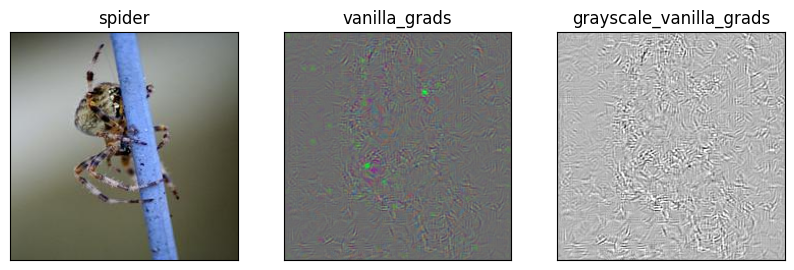

In [7]:
# Specify the index
target_example = 2  # Spider
# Preprocess the image and get the pre-trained alex model for the image
(original_image, prep_img, target_class, file_name_to_export, pretrained_model) = get_example_params(target_example)
# Plot the image
plt.figure(figsize=(10,10))
plt.subplot(131)
plt.title(file_name_to_export)
plt.imshow(original_image)
plt.xticks([])
plt.yticks([])

# Vanilla backprop
VBP = VanillaBackprop(pretrained_model)
# Generate gradients
vanilla_grads = VBP.generate_gradients(prep_img, target_class)
# Calculate the normalized gradients
vanilla_grads = vanilla_grads - vanilla_grads.min()
vanilla_grads /= vanilla_grads.max()
# Plot the normalized the vanilla gradients
plt.subplot(132)
plt.title('vanilla_grads')
plt.imshow(vanilla_grads.transpose(1,2,0))
plt.xticks([])
plt.yticks([])

# Convert the vanilla_grads to grayscale
grayscale_vanilla_grads = convert_to_grayscale(vanilla_grads)
# Normalize the grayscale_vanilla_grads
grayscale_vanilla_grads = grayscale_vanilla_grads - grayscale_vanilla_grads.min()
grayscale_vanilla_grads /= grayscale_vanilla_grads.max()
# Plot the normalized grayscale_vanilla_grads
plt.subplot(133)
plt.title('grayscale_vanilla_grads')
plt.imshow(grayscale_vanilla_grads[0], cmap='gray')
plt.xticks([])
plt.yticks([])
plt.show()

## Gradient visualization with guided backpropagation


Another way to visualize CNN layers is to visualize activations for a specific input on a specific layer and filter. Below example is obtained from layers/filters of AlexNet for the first image using guided backpropagation. The method is quite similar to backpropagation but instead of guiding the signal from the last layer and a specific target, it guides the signal from a specific layer and filter.

In [8]:
class GuidedBackprop():
    def __init__(self, model):
        self.model = model
        self.gradients = None
        self.forward_relu_outputs = []
        # Put model in evaluation mode
        self.model.eval()
        self.update_relus()
        self.hook_layers()

    def hook_layers(self):
        def hook_function(module, grad_in, grad_out):
            self.gradients = grad_in[0]
        # Register hook to the first layer
        first_layer = list(self.model.features._modules.items())[0][1]
        first_layer.register_backward_hook(hook_function)

    def update_relus(self):
        """
            Updates relu activation functions so that
                1- stores output in forward pass
                2- imputes zero for gradient values that are less than zero
        """
        def relu_backward_hook_function(module, grad_in, grad_out):
            """
            If there is a negative gradient, change it to zero
            """
            # Get last forward output
            corresponding_forward_output = self.forward_relu_outputs[-1]
            corresponding_forward_output[corresponding_forward_output > 0] = 1
            modified_grad_out = corresponding_forward_output * torch.clamp(grad_in[0], min=0.0)
            del self.forward_relu_outputs[-1]  # Remove last forward output
            return (modified_grad_out,)

        def relu_forward_hook_function(module, ten_in, ten_out):
            """
            Store results of forward pass
            """
            self.forward_relu_outputs.append(ten_out)

        # Loop through layers, hook up ReLUs
        for pos, module in self.model.features._modules.items():
            if isinstance(module, ReLU):
                module.register_backward_hook(relu_backward_hook_function)
                module.register_forward_hook(relu_forward_hook_function)

    def generate_gradients(self, input_image, target_class, cnn_layer, filter_pos):
        self.model.zero_grad()
        # Forward pass
        x = input_image
        for index, layer in enumerate(self.model.features):
            # Forward pass layer by layer
            # x is not used after this point because it is only needed to trigger
            # the forward hook function
            x = layer(x)
            # Only need to forward until the selected layer is reached
            if index == cnn_layer:
                # (forward hook function triggered)
                break
        conv_output = torch.sum(torch.abs(x[0, filter_pos]))
        # Backward pass
        conv_output.backward()
        # Convert Pytorch variable to numpy array
        # [0] to get rid of the first channel (1,3,224,224)
        gradients_as_arr = self.gradients.data.numpy()[0]
        return gradients_as_arr

## Visualize activations of the first 30 filters in layer 29 for given input



In [9]:
cnn_layer = 29
target_example = 2  # Spider
(original_image, prep_img, target_class, file_name_to_export, pretrained_model) =\
    get_example_params(target_example)

layer_29_filters_visualization = {}
for filter_pos in range(1,31):
    # File export name
    title = file_name_to_export + '_layer' + str(cnn_layer) + '_filter' + str(filter_pos)
    # Guided backprop
    GBP = GuidedBackprop(pretrained_model)
    # Get gradients
    guided_grads = GBP.generate_gradients(prep_img, target_class, cnn_layer, filter_pos)

    guided_grads = guided_grads - guided_grads.min()
    guided_grads /= guided_grads.max()
    layer_29_filters_visualization[title]=guided_grads


<ipython-input-9-3ba0574691a1>:16: RuntimeWarning: invalid value encountered in divide
  guided_grads /= guided_grads.max()


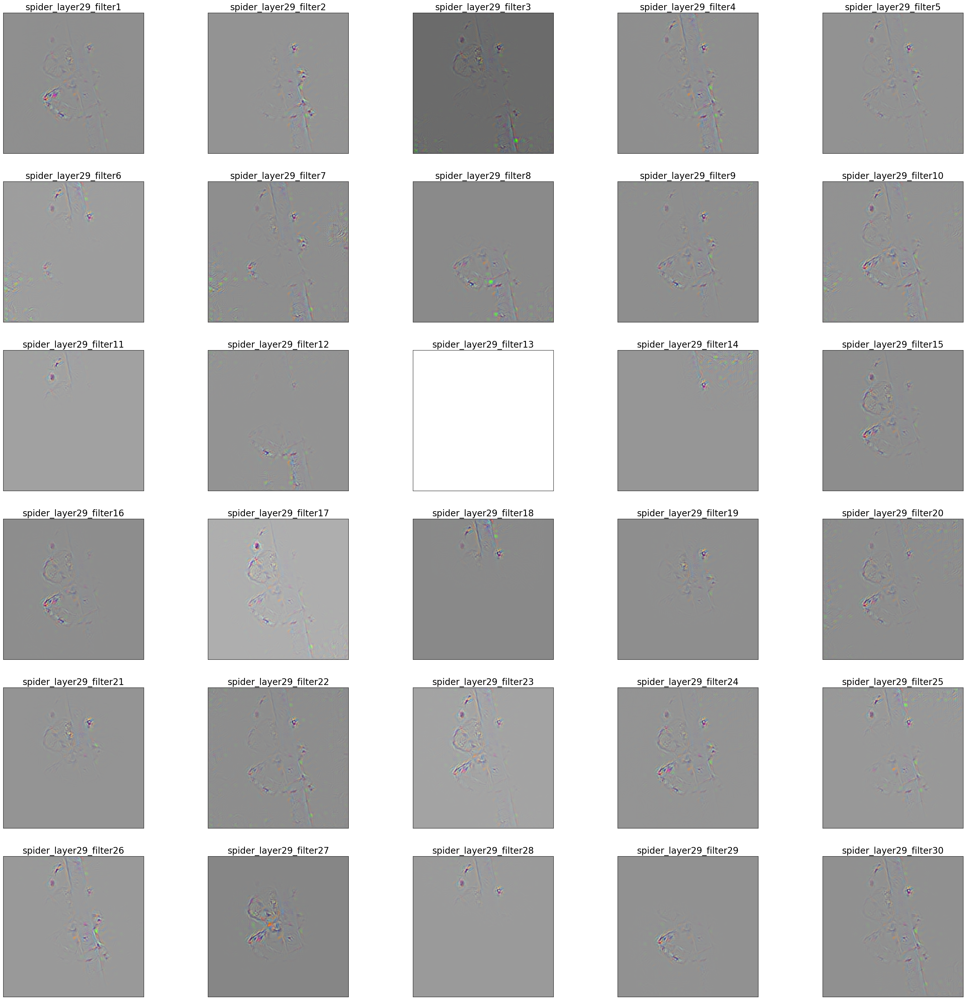

In [10]:
fig, ax = plt.subplots(nrows=6, ncols=5, figsize = (40,40))

for r, row in enumerate(ax):
    for c, col in enumerate(row):
        fil_name = file_name_to_export + '_layer29_filter' + str(r*5+c+1)
        col.imshow(layer_29_filters_visualization[fil_name].transpose(1,2,0))
        col.set_xticks([])
        col.set_yticks([])
        col.set_title(fil_name, fontdict={'fontsize':20})

plt.show()

## Visualize activations of Filter 0 in the first 10 layers of AlexNet for given input

In [11]:
filter_pos = 0
target_example = 2  # Spider
(original_image, prep_img, target_class, file_name_to_export, pretrained_model) =\
    get_example_params(target_example)

filter_0_30layers_visualization = {}
for cnn_layer in range(1,11):
    # File export name
    title = file_name_to_export + '_layer' + str(cnn_layer) + '_filter' + str(filter_pos)
    # Guided backprop
    GBP = GuidedBackprop(pretrained_model)
    # Get gradients
    guided_grads = GBP.generate_gradients(prep_img, target_class, cnn_layer, filter_pos)

    guided_grads = guided_grads - guided_grads.min()
    guided_grads /= guided_grads.max()
    filter_0_30layers_visualization[title]=guided_grads


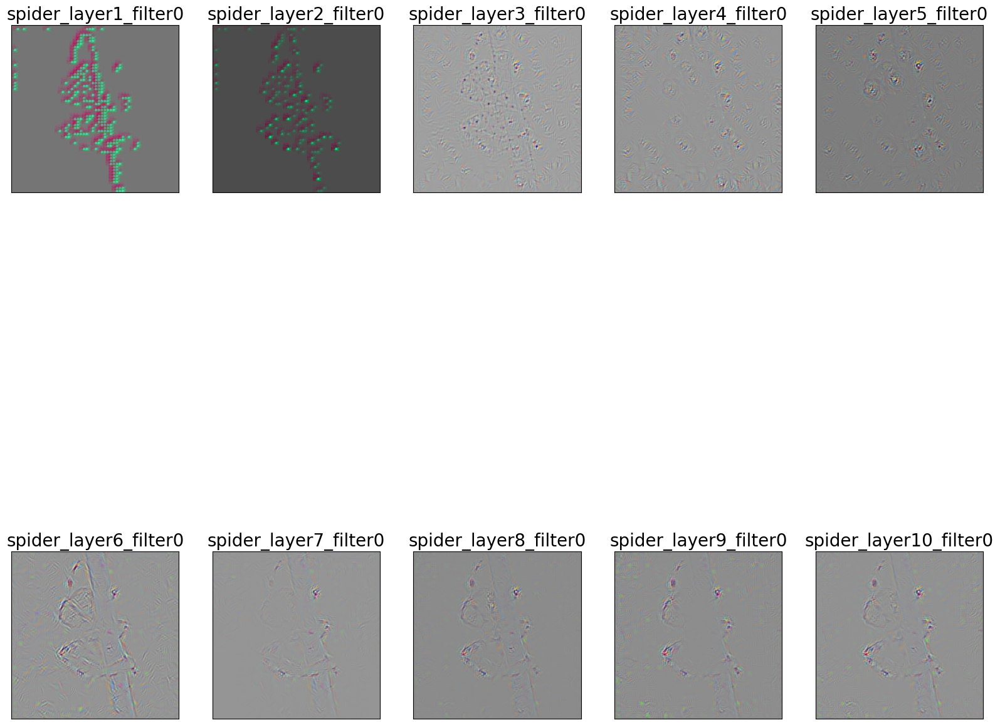

In [12]:
fig, ax = plt.subplots(nrows=2, ncols=5, figsize = (20,20))

for r, row in enumerate(ax):
    for c, col in enumerate(row):
        fil_name = file_name_to_export + '_layer'+str(r*5+c+1)+'_filter0'
        col.imshow(filter_0_30layers_visualization[fil_name].transpose(1,2,0))
        col.set_xticks([])
        col.set_yticks([])
        col.set_title(fil_name, fontdict={'fontsize':20})

plt.show()

## Convolutional Neural Network Filter Visualization

* CNN filters can be visualized when we optimize the input image with respect to output of the specific convolution operation. For this example we used a pre-trained VGG16. Visualizations of layers start with basic color and direction filters at lower levels. As we approach towards the final layer the complexity of the filters also increase. If you employ external techniques like blurring, gradient clipping etc. you will probably produce better images



## VGG Net Architecture

* Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
* Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
* Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
* Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
* Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)

In [13]:
class CNNLayerVisualization():
    def __init__(self, model, selected_layer, selected_filter):
        self.model = model
        self.model.eval()
        self.selected_layer = selected_layer
        self.selected_filter = selected_filter
        self.conv_output = 0
        # Create the folder to export images if not exists
        if not os.path.exists('../generated'):
            os.makedirs('../generated')

    def hook_layer(self):
        def hook_function(module, grad_in, grad_out):
            # Gets the conv output of the selected filter (from selected layer)
            self.conv_output = grad_out[0, self.selected_filter]
        # Hook the selected layer
        self.model[self.selected_layer].register_forward_hook(hook_function)

    def visualise_layer_with_hooks(self):
        # Hook the selected layer
        self.hook_layer()
        # Generate a random image
        random_image = np.uint8(np.random.uniform(150, 180, (224, 224, 3)))
        # Process image and return variable
        processed_image = preprocess_image(random_image, False)
        # Define optimizer for the image
        optimizer = Adam([processed_image], lr=0.1, weight_decay=1e-6)
        for i in range(1, 31):
            optimizer.zero_grad()
            # Assign create image to a variable to move forward in the model
            x = processed_image
            for index, layer in enumerate(self.model):
                # Forward pass layer by layer
                # x is not used after this point because it is only needed to trigger
                # the forward hook function
                x = layer(x)
                # Only need to forward until the selected layer is reached
                if index == self.selected_layer:
                    # (forward hook function triggered)
                    break
            # Loss function is the mean of the output of the selected layer/filter
            # We try to minimize the mean of the output of that specific filter
            loss = -torch.mean(self.conv_output)
            #print('Iteration:', str(i), 'Loss:', "{0:.2f}".format(loss.data.numpy()))
            # Backward
            loss.backward()
            # Update image
            optimizer.step()
            # Recreate image
            self.created_image = recreate_image(processed_image)
            # Save image
            if i % 5 == 0:
                im_path = '../generated/layer_vis_l' + str(self.selected_layer) + \
                    '_f' + str(self.selected_filter) + '_iter' + str(i) + '.jpg'
                save_image(self.created_image, im_path)
        return self.created_image

In [14]:
cnn_layer = 17
filter_visualization_layer_wise = {}
# Fully connected layer is not needed
for filter_pos in tqdm(range(1,26)):
    pretrained_model = models.vgg16(pretrained=True).features
    layer_vis = CNNLayerVisualization(pretrained_model, cnn_layer, filter_pos)

    # Layer visualization with pytorch hooks
    filter_visualization_layer_wise['filter_'+str(filter_pos)]=layer_vis.visualise_layer_with_hooks()

  0%|          | 0/25 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth

  0%|          | 0.00/528M [00:00<?, ?B/s]
  1%|          | 6.38M/528M [00:00<00:08, 66.4MB/s]
  3%|▎         | 15.5M/528M [00:00<00:06, 83.3MB/s]
  5%|▍         | 24.4M/528M [00:00<00:06, 87.3MB/s]
  6%|▋         | 33.9M/528M [00:00<00:05, 91.8MB/s]
  8%|▊         | 43.6M/528M [00:00<00:05, 95.2MB/s]
 10%|█         | 54.8M/528M [00:00<00:04, 102MB/s] 
 12%|█▏        | 64.6M/528M [00:00<00:04, 101MB/s]
 14%|█▍        | 75.0M/528M [00

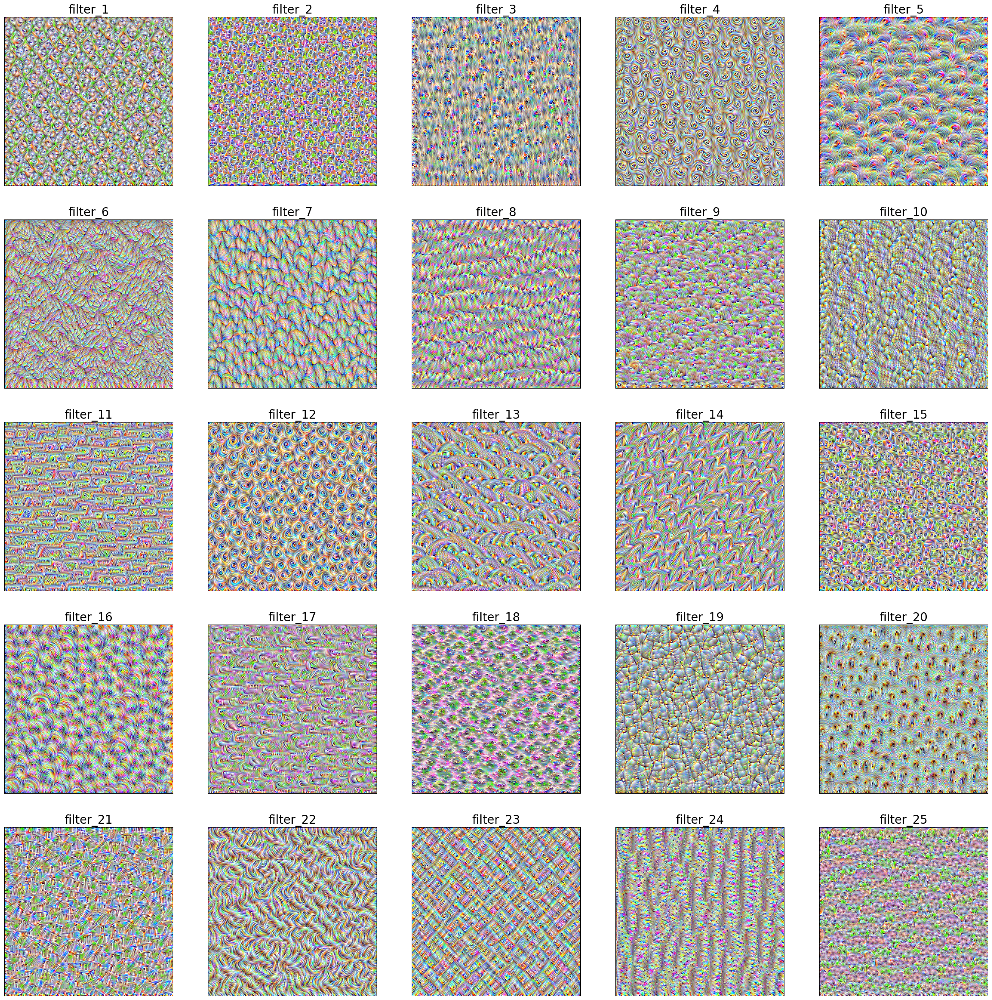

In [15]:
fig, ax = plt.subplots(nrows=5, ncols=5, figsize = (30,30))

for r, row in enumerate(ax):
    for c, col in enumerate(row):
        #print(r,c,r*5+c+1 )
        fil_name = 'filter_'+str((r*5+c+1))
        col.imshow(filter_visualization_layer_wise[fil_name])
        col.set_xticks([])
        col.set_yticks([])
        col.set_title(fil_name, fontdict={'fontsize':20})

plt.show()

## Inverted Representation

* We are using Alexnet for this visualization

## Alexnet Architecture

AlexNet:

Features Extraction:
* Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
* ReLU(inplace)
* MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
* Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
* ReLU(inplace)
* MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
* Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
* ReLU(inplace)
* MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)

Classifier-Sequential:
* Dropout(p=0.5)
* Linear(in_features=9216, out_features=4096, bias=True)
* ReLU(inplace)
* Dropout(p=0.5)
* Linear(in_features=4096, out_features=4096, bias=True)
* ReLU(inplace)
* Linear(in_features=4096, out_features=1000, bias=True)



In [16]:
import torch
from torch.autograd import Variable
from torch.optim import SGD
import os
from misc_functions import get_example_params, recreate_image, save_image

In [17]:
class InvertedRepresentation():
    def __init__(self, model):
        self.model = model
        self.model.eval()
        if not os.path.exists('../generated'):
            os.makedirs('../generated')

    def alpha_norm(self, input_matrix, alpha):
        """
            Converts matrix to vector then calculates the alpha norm
        """
        alpha_norm = ((input_matrix.view(-1))**alpha).sum()
        return alpha_norm

    def total_variation_norm(self, input_matrix, beta):
        """
            Total variation norm is the second norm in the paper
            represented as R_V(x)
        """
        to_check = input_matrix[:, :-1, :-1]  # Trimmed: right - bottom
        one_bottom = input_matrix[:, 1:, :-1]  # Trimmed: top - right
        one_right = input_matrix[:, :-1, 1:]  # Trimmed: top - right
        total_variation = (((to_check - one_bottom)**2 +
                            (to_check - one_right)**2)**(beta/2)).sum()
        return total_variation

    def euclidian_loss(self, org_matrix, target_matrix):
        """
            Euclidian loss is the main loss function in the paper
            ||fi(x) - fi(x_0)||_2^2& / ||fi(x_0)||_2^2
        """
        distance_matrix = target_matrix - org_matrix
        euclidian_distance = self.alpha_norm(distance_matrix, 2)
        normalized_euclidian_distance = euclidian_distance / self.alpha_norm(org_matrix, 2)
        return normalized_euclidian_distance

    def get_output_from_specific_layer(self, x, layer_id):
        """
            Saves the output after a forward pass until nth layer
            This operation could be done with a forward hook too
            but this one is simpler
        """
        layer_output = None
        for index, layer in enumerate(self.model.features):
            x = layer(x)
            if str(index) == str(layer_id):
                layer_output = x[0]
                break
        return layer_output

    def generate_inverted_image_specific_layer(self, input_image, img_size, target_layer=3, layers=False):
        # Generate a random image which we will optimize
        opt_img = Variable(1e-1 * torch.randn(1, 3, img_size, img_size), requires_grad=True)
        # Define optimizer for previously created image
        optimizer = SGD([opt_img], lr=1e4, momentum=0.9)
        # Get the output from the model after a forward pass until target_layer
        # with the input image (real image, NOT the randomly generated one)
        input_image_layer_output = \
            self.get_output_from_specific_layer(input_image, target_layer)

        # Alpha regularization parametrs
        # Parameter alpha, which is actually sixth norm
        alpha_reg_alpha = 6
        # The multiplier, lambda alpha
        alpha_reg_lambda = 1e-7

        # Total variation regularization parameters
        # Parameter beta, which is actually second norm
        tv_reg_beta = 2
        # The multiplier, lambda beta
        tv_reg_lambda = 1e-8
        inverted_images_for_iterations = {}
        for i in range(201):
            optimizer.zero_grad()
            # Get the output from the model after a forward pass until target_layer
            # with the generated image (randomly generated one, NOT the real image)
            output = self.get_output_from_specific_layer(opt_img, target_layer)
            # Calculate euclidian loss
            euc_loss = 1e-1 * self.euclidian_loss(input_image_layer_output.detach(), output)
            # Calculate alpha regularization
            reg_alpha = alpha_reg_lambda * self.alpha_norm(opt_img, alpha_reg_alpha)
            # Calculate total variation regularization
            reg_total_variation = tv_reg_lambda * self.total_variation_norm(opt_img,
                                                                            tv_reg_beta)
            # Sum all to optimize
            loss = euc_loss + reg_alpha + reg_total_variation
            # Step
            loss.backward()
            optimizer.step()
            # Generate image every 5 iterations
            if i % 5 == 0:
                print('Iteration:', str(i), 'Loss:', loss.data.numpy())
                recreated_im = recreate_image(opt_img)
                inverted_images_for_iterations['Iteration'+str(i)]=recreated_im
                im_path = '../generated/Inv_Image_Layer_' + str(target_layer) + \
                    '_Iteration_' + str(i) + '.jpg'
                save_image(recreated_im, im_path)

            # Reduce learning rate every 40 iterations
            if i % 40 == 0:
                for param_group in optimizer.param_groups:
                    param_group['lr'] *= 1/10
        if layers:
            return recreated_im
        return inverted_images_for_iterations


In [18]:
target_example = 2  # 2:spider; 0:snake; 1:dog
(original_image, prep_img, target_class, file_name_to_export, pretrained_model) =\
    get_example_params(target_example)

inverted_representation = InvertedRepresentation(pretrained_model)
image_size = 224  # width & height
target_layer = 4
inverted_images = inverted_representation.generate_inverted_image_specific_layer(prep_img,
                                                               image_size,
                                                               target_layer)


Iteration: 0 Loss: 0.09766217
Iteration: 5 Loss: 0.06172619
Iteration: 10 Loss: 0.04032406
Iteration: 15 Loss: 0.026648594
Iteration: 20 Loss: 0.019502897
Iteration: 25 Loss: 0.015695913
Iteration: 30 Loss: 0.013164459
Iteration: 35 Loss: 0.01134153
Iteration: 40 Loss: 0.009961476
Iteration: 45 Loss: 0.009597115
Iteration: 50 Loss: 0.0094032055
Iteration: 55 Loss: 0.009226177
Iteration: 60 Loss: 0.009068609
Iteration: 65 Loss: 0.008926449
Iteration: 70 Loss: 0.0087973885
Iteration: 75 Loss: 0.008678226
Iteration: 80 Loss: 0.008567158
Iteration: 85 Loss: 0.0085365
Iteration: 90 Loss: 0.0085245585
Iteration: 95 Loss: 0.00851298
Iteration: 100 Loss: 0.008501711
Iteration: 105 Loss: 0.008490655
Iteration: 110 Loss: 0.008479819
Iteration: 115 Loss: 0.008469167
Iteration: 120 Loss: 0.008458705
Iteration: 125 Loss: 0.008455747
Iteration: 130 Loss: 0.008454638
Iteration: 135 Loss: 0.008453563
Iteration: 140 Loss: 0.008452504
Iteration: 145 Loss: 0.008451457
Iteration: 150 Loss: 0.008450419
Ite

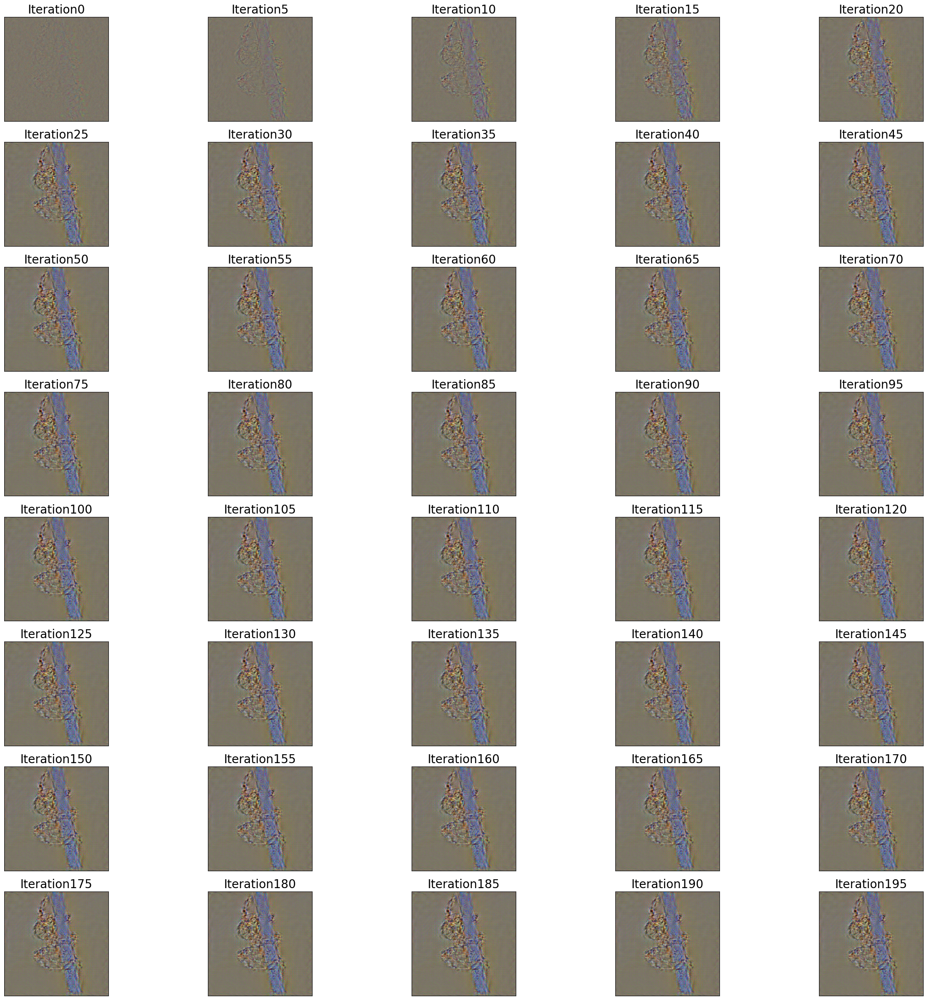

In [19]:
fig, ax = plt.subplots(nrows=8, ncols=5, figsize = (30,30))

for r, row in enumerate(ax):
    for c, col in enumerate(row):
        fil_name = 'Iteration'+str((r*5+c)*5)
        col.imshow(inverted_images[fil_name])
        col.set_xticks([])
        col.set_yticks([])
        col.set_title(fil_name, fontdict={'fontsize':20})

plt.show()

In [20]:
target_example = 2  # spider; 0:snake; 1:dog
(original_image, prep_img, target_class, file_name_to_export, pretrained_model) =\
    get_example_params(target_example)

inverted_representation_per_layer= {}
inverted_representation = InvertedRepresentation(pretrained_model)
image_size = 224  # width & height
for target_layer in range(10):
    (original_image, prep_img, target_class, file_name_to_export, pretrained_model) =\
    get_example_params(target_example)
    inverted_representation = InvertedRepresentation(pretrained_model)
    inverted_image = inverted_representation.generate_inverted_image_specific_layer(prep_img,
                                                               image_size,
                                                               target_layer, layers= True)
    inverted_representation_per_layer[target_layer]= inverted_image

Iteration: 0 Loss: 0.075769976
Iteration: 5 Loss: 0.05624499
Iteration: 10 Loss: 0.04077622
Iteration: 15 Loss: 0.02944931
Iteration: 20 Loss: 0.02311706
Iteration: 25 Loss: 0.019462747
Iteration: 30 Loss: 0.017005367
Iteration: 35 Loss: 0.015309093
Iteration: 40 Loss: 0.014144651
Iteration: 45 Loss: 0.0138829565
Iteration: 50 Loss: 0.013789242
Iteration: 55 Loss: 0.013696378
Iteration: 60 Loss: 0.013606248
Iteration: 65 Loss: 0.013519861
Iteration: 70 Loss: 0.013437579
Iteration: 75 Loss: 0.013359373
Iteration: 80 Loss: 0.0132850045
Iteration: 85 Loss: 0.013264867
Iteration: 90 Loss: 0.01325786
Iteration: 95 Loss: 0.013250944
Iteration: 100 Loss: 0.013244091
Iteration: 105 Loss: 0.013237286
Iteration: 110 Loss: 0.013230522
Iteration: 115 Loss: 0.013223792
Iteration: 120 Loss: 0.013217093
Iteration: 125 Loss: 0.013215224
Iteration: 130 Loss: 0.013214558
Iteration: 135 Loss: 0.013213892
Iteration: 140 Loss: 0.013213229
Iteration: 145 Loss: 0.0132125635
Iteration: 150 Loss: 0.013211899
I

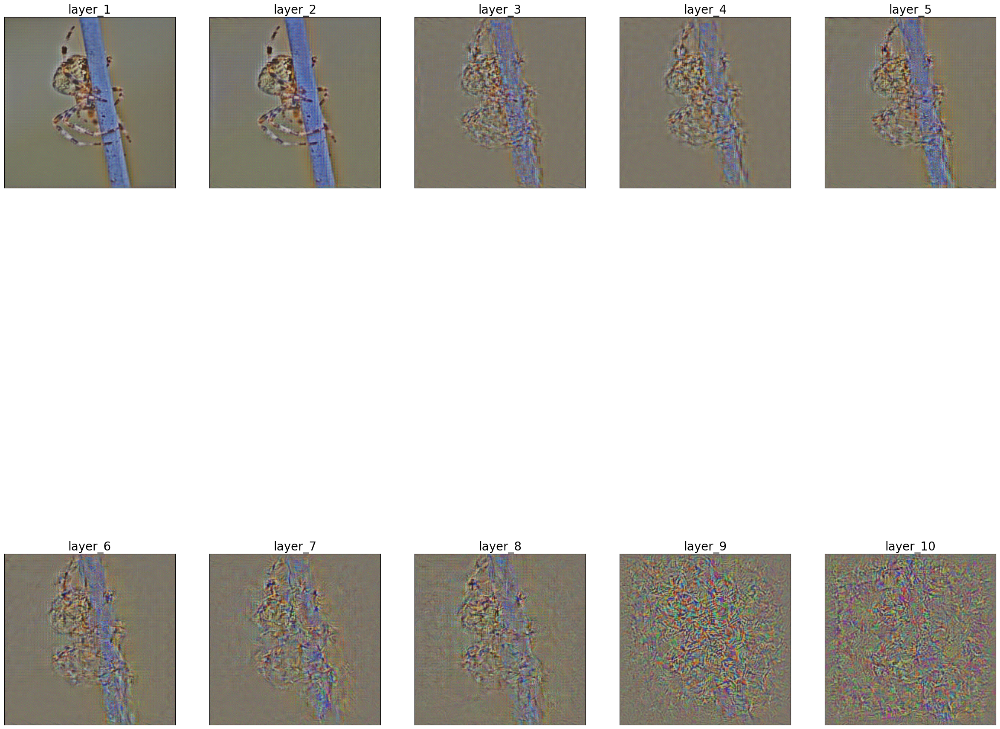

In [21]:
fig, ax = plt.subplots(nrows=2, ncols=5, figsize = (30,30))

for r, row in enumerate(ax):
    for c, col in enumerate(row):
        fil_name = (r*5+c)
        col.imshow(inverted_representation_per_layer[fil_name])
        col.set_xticks([])
        col.set_yticks([])
        col.set_title('layer_'+str(fil_name+1), fontdict={'fontsize':20})

plt.show()

### Please answer the questions below to complete the experiment:




In [22]:
#@title How was the experiment? { run: "auto", form-width: "500px", display-mode: "form" }
Complexity = "" #@param ["","Too Simple, I am wasting time", "Good, But Not Challenging for me", "Good and Challenging for me", "Was Tough, but I did it", "Too Difficult for me"]


In [23]:
#@title If it was too easy, what more would you have liked to be added? If it was very difficult, what would you have liked to have been removed? { run: "auto", display-mode: "form" }
Additional = "" #@param {type:"string"}


In [24]:
#@title Can you identify the concepts from the lecture which this experiment covered? { run: "auto", vertical-output: true, display-mode: "form" }
Concepts = "" #@param ["","Yes", "No"]


In [25]:
#@title  Experiment walkthrough video? { run: "auto", vertical-output: true, display-mode: "form" }
Walkthrough = "" #@param ["","Very Useful", "Somewhat Useful", "Not Useful", "Didn't use"]


In [26]:
#@title  Text and image description/explanation and code comments within the experiment: { run: "auto", vertical-output: true, display-mode: "form" }
Comments = "" #@param ["","Very Useful", "Somewhat Useful", "Not Useful", "Didn't use"]


In [27]:
#@title Mentor Support: { run: "auto", vertical-output: true, display-mode: "form" }
Mentor_support = "" #@param ["","Very Useful", "Somewhat Useful", "Not Useful", "Didn't use"]


In [28]:
#@title Run this cell to submit your notebook for Ungrading { vertical-output: true }
try:
  if submission_id:
      return_id = submit_notebook()
      if return_id : submission_id = return_id
  else:
      print("Please complete the setup first.")
except NameError:
  print ("Please complete the setup first.")

Please answer Complexity Question
